The Python SDK for the Gemini API, is contained in the [`google-generativeai`](https://pypi.org/project/google-generativeai/) package. Install the dependency using pip:


In [ ]:
!pip install -q -U google-generativeai

### Import packages

In [ ]:
import google.generativeai as genai
import pathlib
import textwrap
from IPython.display import display
from IPython.display import Markdown


In [ ]:
def to_markdown(text):
  text = text.replace('•', '  *')
  return Markdown(textwrap.indent(text, '> ', predicate=lambda _: True))


# Example usage:
input_text = "This is a • sample text with bullet points."
result = to_markdown(input_text)

display(result)

> This is a   * sample text with bullet points.

### Setup your API key

Before you can use the Gemini API, you must first obtain an API key. If you don't already have one, create a key with one click in Google AI Studio.

<a class="button button-primary" href="https://makersuite.google.com/app/apikey" target="_blank" rel="noopener noreferrer">Get an API key</a>


In Colab, add the key to the secrets manager under the "🔑" in the left panel. Give it the name `GOOGLE_API_KEY`.

Once you have the API key, pass it to the SDK. You can do this in two ways:

* Put the key in the `GOOGLE_API_KEY` environment variable (the SDK will automatically pick it up from there).
* Pass the key to `genai.configure(api_key=...)`


In [ ]:
# Used to securely store your API key
from google.colab import userdata

In [ ]:
GOOGLE_API_KEY=userdata.get('GOOGLE_API_KEY')

In [ ]:
genai.configure(api_key=GOOGLE_API_KEY)

In [ ]:
for models in genai.list_models():
  print(models)

Model(name='models/chat-bison-001',
      base_model_id='',
      version='001',
      display_name='PaLM 2 Chat (Legacy)',
      description='A legacy text-only model optimized for chat conversations',
      input_token_limit=4096,
      output_token_limit=1024,
      supported_generation_methods=['generateMessage', 'countMessageTokens'],
      temperature=0.25,
      top_p=0.95,
      top_k=40)
Model(name='models/text-bison-001',
      base_model_id='',
      version='001',
      display_name='PaLM 2 (Legacy)',
      description='A legacy model that understands text and generates text as an output',
      input_token_limit=8196,
      output_token_limit=1024,
      supported_generation_methods=['generateText', 'countTextTokens', 'createTunedTextModel'],
      temperature=0.7,
      top_p=0.95,
      top_k=40)
Model(name='models/embedding-gecko-001',
      base_model_id='',
      version='001',
      display_name='Embedding Gecko',
      description='Obtain a distributed representatio

In [ ]:
for models in genai.list_models():
  if 'generateContent' in models.supported_generation_methods:
    print(models.name)

models/gemini-pro
models/gemini-pro-vision


# Generate text from text inputs

In [ ]:
model = genai.GenerativeModel('gemini-pro')

In [ ]:
%%time
response = model.generate_content("What is the meaning of life?")

CPU times: user 118 ms, sys: 7.86 ms, total: 126 ms
Wall time: 9 s


In [ ]:
response.text

'Philosophers and people from all walks of life have pondered the meaning of life for centuries, and there is no single answer that is universally accepted. Different people find meaning in different things, and what is meaningful to one person may not be meaningful to another. Some common themes that emerge when discussing the meaning of life include:\n\n**Purpose:** Many people find meaning in their lives by pursuing a purpose or goal. This could be anything from raising a family to achieving a career ambition to making a difference in the world.\n\n**Relationships:** Strong and loving relationships with family and friends can provide a sense of purpose and meaning to life. Feeling connected to others and being part of a community can also contribute to a sense of well-being and fulfillment.\n\n**Personal growth and development:** Some people find meaning in life by constantly learning and growing as a person. This could involve taking classes, reading books, traveling, or simply try

In [ ]:
to_markdown(response.text)

> Philosophers and people from all walks of life have pondered the meaning of life for centuries, and there is no single answer that is universally accepted. Different people find meaning in different things, and what is meaningful to one person may not be meaningful to another. Some common themes that emerge when discussing the meaning of life include:
> 
> **Purpose:** Many people find meaning in their lives by pursuing a purpose or goal. This could be anything from raising a family to achieving a career ambition to making a difference in the world.
> 
> **Relationships:** Strong and loving relationships with family and friends can provide a sense of purpose and meaning to life. Feeling connected to others and being part of a community can also contribute to a sense of well-being and fulfillment.
> 
> **Personal growth and development:** Some people find meaning in life by constantly learning and growing as a person. This could involve taking classes, reading books, traveling, or simply trying new things. Personal growth can lead to a greater sense of self-awareness and fulfillment.
> 
> **Service to others:** Many people find meaning in life by helping others. This could involve volunteering, donating to charity, or simply being kind and compassionate to those around you. Service to others can help you feel connected to your community and make a difference in the world.
> 
> **Creativity and self-expression:** Some people find meaning in life through creative pursuits, such as art, music, writing, or dance. Creative expression can allow you to communicate your thoughts and feelings in a unique way and can also be a source of great joy and satisfaction.
> 
> **Spiritual or religious beliefs:** For many people, their spiritual or religious beliefs provide a sense of meaning and purpose in life. These beliefs can offer comfort and guidance during difficult times and can help people to connect with something greater than themselves.
> 
> Ultimately, the meaning of life is a personal journey, and there is no right or wrong answer. What is important is to find what gives you a sense of purpose, fulfillment, and joy.

In [ ]:
response.candidates

[content {
  parts {
    text: "Philosophers and people from all walks of life have pondered the meaning of life for centuries, and there is no single answer that is universally accepted. Different people find meaning in different things, and what is meaningful to one person may not be meaningful to another. Some common themes that emerge when discussing the meaning of life include:\n\n**Purpose:** Many people find meaning in their lives by pursuing a purpose or goal. This could be anything from raising a family to achieving a career ambition to making a difference in the world.\n\n**Relationships:** Strong and loving relationships with family and friends can provide a sense of purpose and meaning to life. Feeling connected to others and being part of a community can also contribute to a sense of well-being and fulfillment.\n\n**Personal growth and development:** Some people find meaning in life by constantly learning and growing as a person. This could involve taking classes, reading 

In [ ]:
response.parts

[text: "Philosophers and people from all walks of life have pondered the meaning of life for centuries, and there is no single answer that is universally accepted. Different people find meaning in different things, and what is meaningful to one person may not be meaningful to another. Some common themes that emerge when discussing the meaning of life include:\n\n**Purpose:** Many people find meaning in their lives by pursuing a purpose or goal. This could be anything from raising a family to achieving a career ambition to making a difference in the world.\n\n**Relationships:** Strong and loving relationships with family and friends can provide a sense of purpose and meaning to life. Feeling connected to others and being part of a community can also contribute to a sense of well-being and fulfillment.\n\n**Personal growth and development:** Some people find meaning in life by constantly learning and growing as a person. This could involve taking classes, reading books, traveling, or sim

In [ ]:
response.prompt_feedback

safety_ratings {
  category: HARM_CATEGORY_SEXUALLY_EXPLICIT
  probability: NEGLIGIBLE
}
safety_ratings {
  category: HARM_CATEGORY_HATE_SPEECH
  probability: NEGLIGIBLE
}
safety_ratings {
  category: HARM_CATEGORY_HARASSMENT
  probability: NEGLIGIBLE
}
safety_ratings {
  category: HARM_CATEGORY_DANGEROUS_CONTENT
  probability: NEGLIGIBLE
}

In [ ]:
%%time
response = model.generate_content("What is the meaning of life?", stream=True)
for chunk in response:
  print(chunk.text)
  print("_"*80)

The meaning of life is a question that has been pondered by philosophers, theologians,
________________________________________________________________________________
 and scientists for centuries. There is no one definitive answer, as the meaning of life is subjective and personal. Some people find meaning in religion or spirituality, while
________________________________________________________________________________
 others find it in their relationships, work, or hobbies. Ultimately, the meaning of life is whatever an individual finds to be meaningful and fulfilling.

Here are some common answers to the question of what is the meaning of life:

* **To be happy.** This is a common answer, and for many people,
________________________________________________________________________________
 it is the ultimate goal of life. Happiness can be found in many different ways, such as through relationships, work, hobbies, or spirituality.
* **To make a difference.** Some people find meani

## Generate text from image and text inputs

Gemini provides a multimodal model (`gemini-pro-vision`) that accepts both text and images and inputs. The `GenerativeModel.generate_content` API is designed to handle multimodal prompts and returns a text output.

Let's include an image:

In [ ]:
!curl -o image.jpg https://t0.gstatic.com/licensed-image?q=tbn:ANd9GcQ_Kevbk21QBRy-PgB4kQpS79brbmmEG7m3VOTShAn4PecDU5H5UxrJxE3Dw1JiaG17V88QIol19-3TM2wCHw

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  405k  100  405k    0     0  5254k      0 --:--:-- --:--:-- --:--:-- 5329k


In [ ]:
!curl -o image2.jpg https://images.pexels.com/photos/414612/pexels-photo-414612.jpeg?cs=srgb&dl=pexels-james-wheeler-414612.jpg&fm=jpg

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 1498k  100 1498k    0     0  6717k      0 --:--:-- --:--:-- --:--:-- 6749k


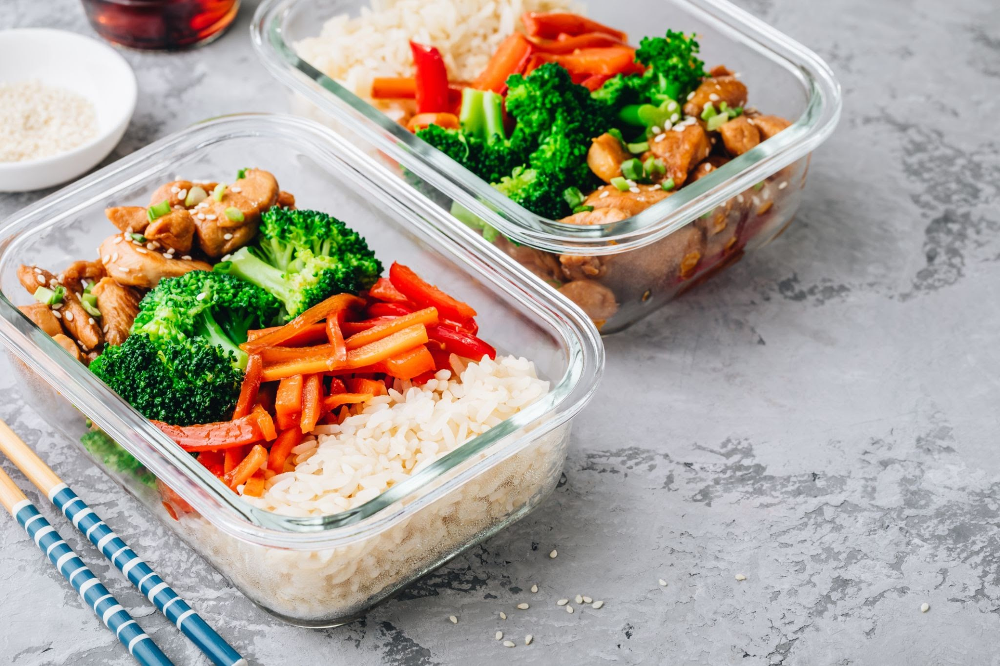

In [ ]:
import PIL.Image

img1 = PIL.Image.open('image.jpg')
img1

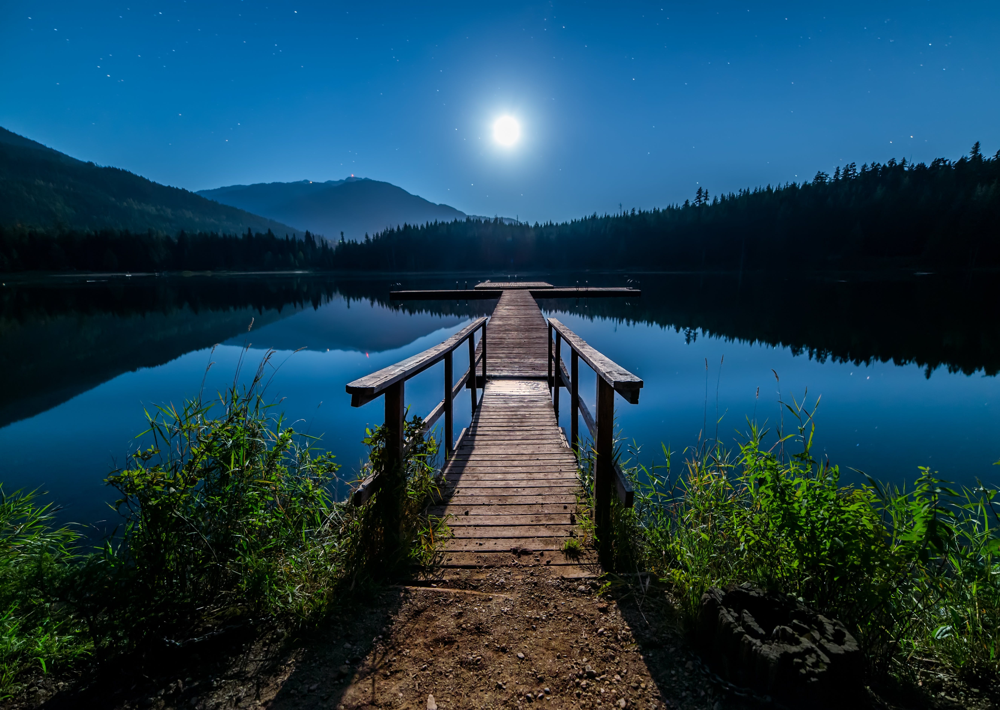

In [ ]:
import PIL.Image

img2 = PIL.Image.open('image2.jpg')
img2

In [ ]:
model2 = genai.GenerativeModel('gemini-pro-vision')

NameError: name 'genai' is not defined

In [ ]:
response = model2.generate_content(img)

to_markdown(response.text)

In [ ]:
response = model2.generate_content(["Write a short, engaging blog post based on this picture. It should include a description of the meal in the photo and talk about my journey meal prepping.", img], stream=True)
response.resolve()

In [ ]:
to_markdown(response.text)

## Chat conversations

Gemini enables you to have freeform conversations across multiple turns. The `ChatSession` class simplifies the process by managing the state of the conversation, so unlike with `generate_content`, you do not have to store the conversation history as a list.

Initialize the chat: